### БД ОПЯ. Сильные ветры.

In [3]:
import pandas as pd
import re
import matplotlib.pyplot as plt
from wordcloud import WordCloud
import plotly.express as px
import nltk
from nltk.corpus import stopwords
from nltk.tokenize import TweetTokenizer, WordPunctTokenizer
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from nltk.tokenize import word_tokenize
from collections import Counter

In [4]:
data = pd.read_excel('files//data_edited.xlsx')

In [5]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 30053 entries, 0 to 30052
Data columns (total 32 columns):
 #   Column                  Non-Null Count  Dtype         
---  ------                  --------------  -----         
 0   _ID                     30053 non-null  object        
 1   Event_ID                23866 non-null  object        
 2   News_link               30053 non-null  object        
 3   Text                    30053 non-null  object        
 4   News_length             30053 non-null  int64         
 5   Repeat_num              30053 non-null  int64         
 6   News_source             30053 non-null  object        
 7   News_type               30053 non-null  object        
 8   Location_ATD4           29914 non-null  object        
 9   Location_other          26845 non-null  object        
 10  Location_geocoded       30053 non-null  object        
 11  Location_geocoded_bool  30053 non-null  bool          
 12  Phenomena               30053 non-null  object

### Посмотрим, какие опасные природные явления есть в базе и в каком количестве

In [160]:
def to_ph_dict(value):
    if isinstance(value, str) and value:
        for i in re.split(r'[;,]', value):
            i = i.strip()
            if i and i[0].isalpha():
                if i in ph_dict:
                    ph_dict[i] += 1
                else:
                    ph_dict[i] = 1
    else:
        if 'nothing' in ph_dict:
            ph_dict['nothing'] += 1
        else:
            ph_dict['nothing'] = 1            
ph_dict = {}
data['Phenomena'].apply(to_ph_dict)
print(f'Длина словаря с ОПЯ: {len(ph_dict)}')

Длина словаря с ОПЯ: 21


In [161]:
phenomena_df = pd.DataFrame(columns = ['ОПЯ', 'Количество'], data = sorted(ph_dict.items(), key = lambda x: x[1], reverse = True))
phenomena_df.head()

,ОПЯ,Количество
0,сильные осадки,8440
1,КНПЯ,6540
2,гололед,5185
3,наводнение,4930
4,сильные ветры,3090


In [5]:
phenomena_df['ОПЯ'].unique()

array(['сильные осадки', 'КНПЯ', 'гололед', 'наводнение', 'сильные ветры',
       'град', 'ландшафтные пожары', 'мороз', 'заморозки', 'лавины',
       'туман', 'жара', 'вредители и болезни лесов и с/х', 'сели',
       'грозы', 'оползни', 'осыпи', 'обвалы', 'пыльные бури', 'засуха',
       'термокарст и деградация мерзлоты'], dtype=object)

In [6]:
phenomena_df

,ОПЯ,Количество
0,сильные осадки,8440
1,КНПЯ,6540
2,гололед,5185
3,наводнение,4933
4,сильные ветры,3090
5,град,2940
6,ландшафтные пожары,2805
7,мороз,2606
8,заморозки,1160
9,лавины,899


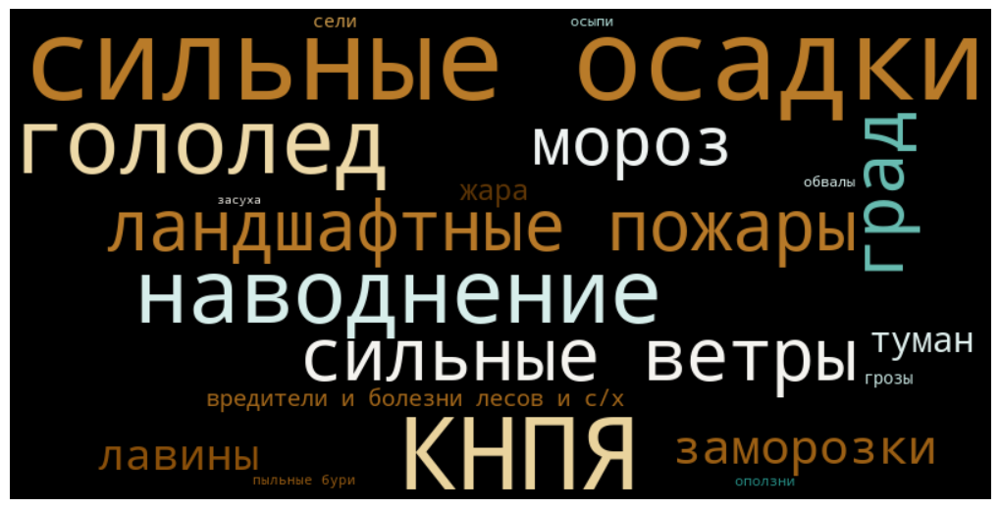

In [7]:
wordcloud = WordCloud(
    width=800,
    height=400,
colormap = 'BrBG',
    background_color='black',
    min_font_size=10,
    max_font_size=100
).generate_from_frequencies(dict(zip(phenomena_df['ОПЯ'], phenomena_df['Количество'])))


plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.subplots_adjust(left=0, right=1, top=1, bottom=0)

plt.show()

### Посмотрим, в каких регионах чаще всего и вообще в принципе встречается какое-либо ОПЯ

In [8]:
def to_ph_sub_dict(ph, sub):
    sub_lst = []
    ph_lst = []
    if isinstance(sub, str) and sub:
        for i in re.split(r'[;,]', sub):
            i = i.strip()
            if i and i[0].isalpha():
                sub_lst.append(i)

    else:
        sub_lst.append('_')
    if isinstance(ph, str) and ph:
        for i in re.split(r'[;,]', ph):
            i = i.strip()
            if i and i[0].isalpha():
                ph_lst.append(i)

    else:
        ph_lst.append('_')
    for p in ph_lst:
        if p not in ph_sub_dict:
           ph_sub_dict[p]={}
        for s in sub_lst:
            if s in ph_sub_dict[p]:
                ph_sub_dict[p][s]+=1
            else:
                ph_sub_dict[p][s]=1
          


ph_sub_dict = {}
data.apply(lambda row: to_ph_sub_dict(row['Phenomena'], row['Location_ATD4']), axis=1)
ph_sub_data_dict = ph_sub_dict.copy()

ph_sub_dict = {}
wind.apply(lambda row: to_ph_sub_dict(row['Phenomena'], row['Location_ATD4']), axis=1)
ph_sub_wind_dict = ph_sub_dict.copy()
print(f'Длина словаря data с ОПЯ: {len(ph_sub_data_dict)}')
print(f'Длина словаря wind с ОПЯ: {len(ph_sub_wind_dict)}')

Длина словаря с ОПЯ: 21


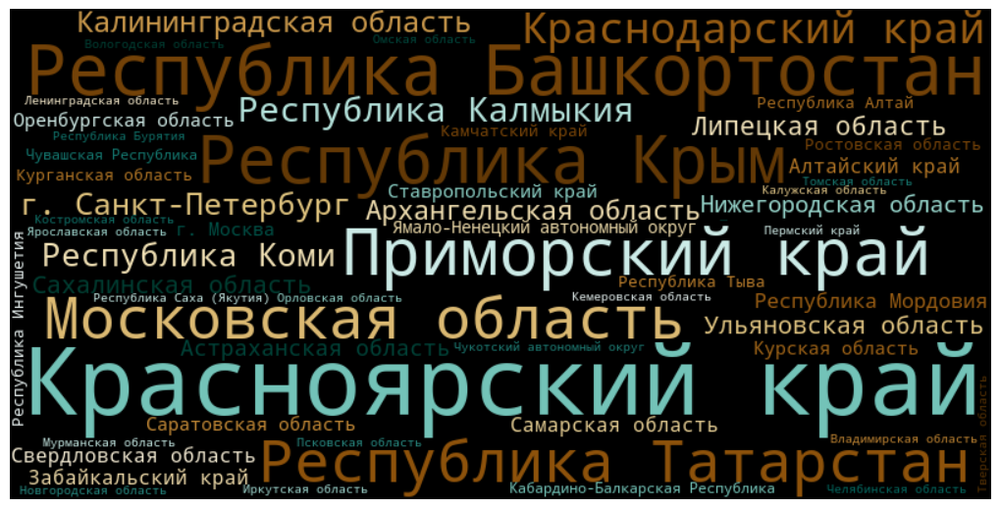

In [9]:
x = 'сильные ветры' # Тут можно написать любое ОПЯ и получить облако слов субъектов конкретно для него

wordcloud = WordCloud(
    width=800,
    height=400,
colormap = 'BrBG',
    background_color='black',
    min_font_size=10,
    max_font_size=100
).generate_from_frequencies(ph_sub_dict[x])


plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.subplots_adjust(left=0, right=1, top=1, bottom=0)

plt.show()

In [10]:
ph_sub_dict = dict(sorted(ph_sub_dict.items(), key=lambda item: sum(item[1].values()), reverse=True))

### Далее сфокусируемся именно на сильных ветрах
#### Отфильтруем те новости, где в  `phenomena` есть упоминаение сильного ветра

In [4]:
x = 'сильные ветры'

In [5]:
def find_classes(series):    
    return series.str.contains(x, regex=True, na=False)

target = data[find_classes(data['Phenomena'])].reset_index(drop=True)
print(f'Размер:{target.shape}')
target.head()

Размер:(3090, 30)


,_ID,Event_ID,News_link,Text,News_length,Количество,News_source,News_type,Location_ATD4,Location_other,...,Activities,Verification_source,Verification_details,Date_year,Date_start,Date_end,fix_Date_start,fix_Date_end,Date_period,Date_post
0,9dc8dd18-9ad7-4021-b9e1-f47356d16cd4,ветер_2024-04_9dc8dd18,https://vk.com/wall-202031839_11811,🔹В Ангарском округе устраняют последствия непо...,2012,1,ВКонтакте,событие,Иркутская область,"Ангарск; Савватеевка; СНТ ""Саяны-4""",...,После начала шквалистого ветра 'Ангарские элек...,NaN,NaN,2024,2024-04-30,2024-01-05,2024-04-30,2024-05-01,1.0,2024-05-01 9:01
1,51b67213-112a-4022-a8f7-92b94b413bf3,ветер_2024-04_92b07a55,https://vk.com/wall-170323951_2534,❗ВНИМАНИЕ ❗ На Центральную Россию надвигается...,790,1,ВКонтакте,прогноз/предупреждение,Орловская область,Новосильский район,...,Просим быть внимательнее. Берегите себя! Телеф...,NaN,NaN,2024,2024-04-19,2023-12-02,2024-04-19,2024-12-02,227.0,2024-04-19 8:54
2,6b78dfdf-c862-4bdb-9d1f-3c58df0eb64b,ветер_2024-04_92b07a55,https://vk.com/wall-140142394_17997,⚠️ Внимание! Экстренное предупреждение! ☔ П...,401,1,ВКонтакте,прогноз/предупреждение,Орловская область,Орловский округ,...,Просим вас быть осторожными и по возможности н...,NaN,NaN,2024,2024-04-19,2019-08-26,2024-04-19,2024-08-26,129.0,2024-04-19 9:40
3,cd7b7cd0-3f73-411d-b3ff-cac598186cac,ветер_2022-07_cd7b7cd0,https://vk.com/wall-94021269_76740,☔В Рязани в ближайшее время ожидаются гроза и ...,525,1,ВКонтакте,прогноз/предупреждение,Рязанская область,Рязань,...,Рязанцев просят быть осторожными и внимательны...,NaN,NaN,2022,2022-07-22,2022-11-17,2022-07-22,2022-11-17,118.0,2022-07-22 16:47
4,0ffbd044-2628-4ceb-8904-739242c2c09c,ветер_2020-06_c5cdf5d8,https://vk.com/wall-111648778_11430,14 июля в поселке Болонь ураганом были поврежд...,312,1,ВКонтакте,событие,Рязанская область,п. Болонь,...,За счет средств резервного фонда Губернатора Р...,NaN,NaN,2020,2020-07-01,2020-10-15,2020-07-01,2020-10-15,106.0,2020-11-09 16:44


In [6]:
len(target['Activities'].unique()) # меры и мероприятия

2868

In [7]:
target['News_type'].value_counts() # типы новостей

News_type
прогноз/предупреждение    1914
событие                   1158
другое                      16
не событие                   2
Name: count, dtype: int64

In [8]:
target['News_source'].value_counts() # Источнки

News_source
ВКонтакте    2585
МЧС           409
СМИ            96
Name: count, dtype: int64

In [9]:
target_be = target[target['News_type']=='событие']

In [10]:
len(target_be['Activities'].unique()) # меры и мероприятия, содержащиеся в новостях типа "событие"

1075

In [11]:
target_be['News_source'].value_counts() # источники новостей типа "событие"

News_source
ВКонтакте    1023
СМИ            90
МЧС            45
Name: count, dtype: int64

### Найдем все новости с сильными ветрами через регулярные выражения

In [13]:
p1 = r'(?<!с)\b(?:(\d+)\s*м\s*/\s*c|(\d+)\s*м\s*/\s*с(?!у)|(\d+)\s*м\s*/\s*сек|' + \
        r'(\d+)\s*м\s*/\s*cек|(\d+)\s*м\s*с|м\s*/\s*c(?!у)|м\s*/\s*сек)\b|' + \
        r'(?<!с)м\s*/\s*с(?!у)|\bметров?\s+в\s+секунду|' + \
        r'\bметр\s+в\s+секунду|\bметра\s+в\s+секунду|' + \
        r'\b(ветер)(?!ин|ан)|\b(ветр)(?!янка)|шторм|ураган|тайфун|' + \
        r'(?<!снежн)(?<!снежной)(?<!снежные)\b' + \
        r'(?<!(снежная|снежной|снежных|снежные)\s)\b(буря|буре|бури|' + \
        r'бурях|бурь|бурей)\b|шквал|смерч|бофорт|порывы|\bдует\b|\bподует\b|\bнадует\b|\bсдует\b'

p2 = r'куб.м/(c|сек)|(куб.|кубического|кубических|кубическому|' + \
r'кубических|кубический)\s*м\s*/\s*(c|сек)|(куб.|кубического|кубических|кубическому|' + \
r'кубических|кубический)\s*(метров|метра|метру|метр)\s+в\s+секунду|' + \
r'штормовое|штормового предупреждения|штормовом предупреждении'

# def find_ph(series):
    
#     return series.str.contains(
#         r'(?<!с)\b(?:(\d+)\s*м\s*/\s*c|(\d+)\s*м\s*/\s*с(?!у)|(\d+)\s*м\s*/\s*сек|' + \
#         r'(\d+)\s*м\s*/\s*cек|(\d+)\s*м\s*с|м\s*/\s*c(?!у)|м\s*/\s*сек)\b|' + \
#         r'(?<!с)м\s*/\s*с(?!у)|\bметров?\s+в\s+секунду|' + \
#         r'\bметр\s+в\s+секунду|\bметра\s+в\s+секунду|' + \
#         r'\b(ветер)(?!ин|ан)|\b(ветр)(?!янка)|шторм|ураган|тайфун|' + \
#         r'(?<!снежн)(?<!снежной)(?<!снежные)\b' + \
#         r'(?<!(снежная|снежной|снежных|снежные)\s)\b(буря|буре|бури|' + \
#         r'бурях|бурь|бурей)\b|шквал|смерч|бофорт|порывы',
#                                regex=True, na=False, flags=re.IGNORECASE)
def find_ph(series):
    # Функция для проверки каждой ячейки
    def check_row(text):
        count_p1 = len([m.group(0) for m in re.finditer(p1, text, flags=re.IGNORECASE)])
        count_p2 = len([m.group(0) for m in re.finditer(p2, text, flags=re.IGNORECASE)])

        return count_p1 > count_p2
    
    # Применяем функцию к каждой ячейке
    return series.apply(check_row)
def find_classes(series):    
    return series.str.contains(x, regex=True, na=False, flags=re.IGNORECASE)
    
target_wind = target[find_ph(target['Text'])]
target_wind = target_wind.reset_index(drop=True)

nope = target[~find_ph(target['Text'])]
nope = nope.reset_index(drop=True)

wind = data[find_ph(data['Text'])]
wind = wind.reset_index(drop=True)

other_wind = wind[~find_classes(wind['Phenomena'])]
other_wind = other_wind.reset_index(drop=True)
print(f'Количество новостей с указанным Hazard_type = "Сильные ветры": {len(target)}')
print(f'Количество новостей с указанным Hazard_type = "Сильные ветры", регулярки: {len(target_wind)}')
print(f'Количество новостей, поиск Hazard_type = "Сильные ветры" с помощью регулярок: {len(wind)}')
print(f'Количество новостей, поиск Hazard_type = "Сильные ветры" с помощью регулярок, где Hazard_type != "Сильные ветры": {len(other_wind)}')

Количество новостей с указанным Hazard_type = "Сильные ветры": 3090
Количество новостей с указанным Hazard_type = "Сильные ветры", регулярки: 2977
Количество новостей, поиск Hazard_type = "Сильные ветры" с помощью регулярок: 12734
Количество новостей, поиск Hazard_type = "Сильные ветры" с помощью регулярок, где Hazard_type != "Сильные ветры": 9757


#### Мини-вывод: оказалось, что новостей с сильными ветрами в 4.1 раза больше
Если считать, что регулярные выражения хорошо справляются с задачей (брать их за истину), то метрики определения класса `Сильные ветры` gpt-моделью следующие
- `Precision` = 2977 / 3090 = `0.96`
- `Recall` = 2977 / 12734 = `0.23`

In [540]:
# nope.to_excel('files/nope.xlsx')
# other_wind.to_excel('files/other_wind.xlsx')

### `data и wind`. Встречаемость ОПЯ (1 или в списке из нескольких ОПЯ)
#### Начнем с `data` - это вся БД ОПЯ

#### Мини пояснение
- `Количество таких ОПЯ (группа), %` - Процент данных ОПЯ от группы с другими ОПЯ (то есть, если мы рассматриваем группу, где в строке только 1 ОПЯ, то этот процент будет считаться от всех таких строк
- `Количество таких ОПЯ (ОПЯ), %` - Процент даных ОПЯ в заданной группе от этих же ОПЯ, но во всех группах (то есть, если мы рассматриваем ОПЯ сильные ветры, то мы будем делить сильные ветры в группе, например, 1 ОПЯ в строке на все строки с сильными ветрами

In [102]:
times_dictt = {}
times_ph_dictt = {}
ph_dict = {}
data['Phenomena'].apply(to_ph_dict)
print(f'Длина словаря с ОПЯ: {len(ph_dict)}')
rows = []

for key, sub_dict in times_ph_dictt.items():
    for sub_key, value in sub_dict.items():
        rows.append([key, sub_key, value])

times_ph_dictt_data_df = pd.DataFrame(rows, columns=['Количество ОПЯ в строке', 'ОПЯ', 'Количество таких ОПЯ'])
# times_ph_dictt_data_df = times_ph_dictt_data_df.sort_values(by=['Количество ОПЯ в строке',
#                                                                 'Количество таких ОПЯ'],
#                                                             ascending = [True, False])
total_counts_data = times_ph_dictt_data_df.groupby(by = 'Количество ОПЯ в строке')['Количество таких ОПЯ'].transform('sum')
total_counts_hazard = times_ph_dictt_data_df.groupby(by = 'ОПЯ')['Количество таких ОПЯ'].transform('sum')
times_ph_dictt_data_df['Количество таких ОПЯ (группа), %'] = round(times_ph_dictt_data_df['Количество таких ОПЯ'] / total_counts_data * 100,2)
times_ph_dictt_data_df['Количество таких ОПЯ (ОПЯ), %'] = round(times_ph_dictt_data_df['Количество таких ОПЯ'] / total_counts_hazard * 100,2)
times_ph_dictt_data_df = times_ph_dictt_data_df.sort_values(by=['Количество ОПЯ в строке',
                                                                'Количество таких ОПЯ (ОПЯ), %'],
                                                            ascending = [True, False])
times_ph_dictt_data_df.head(20)

Длина словаря с ОПЯ: 21


,Количество ОПЯ в строке,ОПЯ,Количество таких ОПЯ,"Количество таких ОПЯ (группа), %","Количество таких ОПЯ (ОПЯ), %"
16,1,термокарст и деградация мерзлоты,1,0.00,100.00
4,1,вредители и болезни лесов и с/х,220,1.03,99.10
3,1,ландшафтные пожары,2622,12.24,93.48
1,1,наводнение,4191,19.56,84.96
10,1,лавины,744,3.47,82.76
0,1,сильные ветры,2500,11.67,80.91
2,1,сильные осадки,5896,27.52,69.86
8,1,засуха,41,0.19,61.19
11,1,жара,192,0.90,53.33
9,1,заморозки,545,2.54,46.98


In [18]:
def show_hazards(df):
    oproya_options = df['ОПЯ'].unique()  
    
    # Создаем список конфигураций для dropdown  
    dropdown_buttons = []  
    
    for opr in oproya_options:  
        # Фильтруем данные по текущему 'ОПЯ'  
        filtered_df = df[df['ОПЯ'] == opr]  
        # Создаем кнопку для этого 'ОПЯ'  
        button = dict(  
            label=opr,  
            method="update",  
            args=[{"x": [filtered_df['Количество ОПЯ в строке']],  
                   "y": [filtered_df['Количество таких ОПЯ']],  
                   "marker": {"color": [opr]},  # можно оставить без изменения или добавить  
                   },  
                  {"title": f"ОПЯ: {opr}"}]  
        )  
        dropdown_buttons.append(button)  
    
    # Создаем начальный график с первым 'ОПЯ'  
    initial_opya = oproya_options[0]  
    initial_df = df[df['ОПЯ'] == initial_opya]  
    
    fig = px.bar(  
        initial_df,  
        x='Количество ОПЯ в строке',  
        y='Количество таких ОПЯ',  
        labels={'Количество ОПЯ в строке': 'Количество ОПЯ в строке',
                'Количество таких ОПЯ': 'Количество таких ОПЯ'},  
        title=f'ОПЯ: {initial_opya}'  
    )  
    
    # Обновляем расположение buttons  
    fig.update_layout(  
        updatemenus=[  
            dict(  
                buttons=dropdown_buttons,  
                direction="down",  
                showactive=True,  
                x=0,  
                y=1.1,  
                xanchor='left',  
                yanchor='top'  
            )  
        ]  
    )  
    
    fig.show()


In [19]:
show_hazards(times_ph_dictt_data_df)

In [103]:
times_ph_dictt_data_df[times_ph_dictt_data_df['Количество ОПЯ в строке']==1]

,Количество ОПЯ в строке,ОПЯ,Количество таких ОПЯ,"Количество таких ОПЯ (группа), %","Количество таких ОПЯ (ОПЯ), %"
16,1,термокарст и деградация мерзлоты,1,0.00,100.00
4,1,вредители и болезни лесов и с/х,220,1.03,99.10
3,1,ландшафтные пожары,2622,12.24,93.48
1,1,наводнение,4191,19.56,84.96
10,1,лавины,744,3.47,82.76
0,1,сильные ветры,2500,11.67,80.91
2,1,сильные осадки,5896,27.52,69.86
8,1,засуха,41,0.19,61.19
11,1,жара,192,0.90,53.33
9,1,заморозки,545,2.54,46.98


### Рассмотрим все то же самое для части БД с сильными ветрами, которые м нашли через регулярные выражения выше

In [104]:
times_dictt = {}
times_ph_dictt = {}
ph_dict = {}
wind['Phenomena'].apply(to_ph_dict)
print(f'Длина словаря с ОПЯ: {len(ph_dict)}')
rows = []

for key, sub_dict in times_ph_dictt.items():
    for sub_key, value in sub_dict.items():
        rows.append([key, sub_key, value])

times_ph_dictt_wind_df = pd.DataFrame(rows, columns=['Количество ОПЯ в строке', 'ОПЯ', 'Количество таких ОПЯ'])
# times_ph_dictt_wind_df = times_ph_dictt_wind_df.sort_values(by=['Количество ОПЯ в строке',
#                                                                 'Количество таких ОПЯ'],
#                                                             ascending = [True, False])


total_counts_wind = times_ph_dictt_wind_df.groupby(by = 'Количество ОПЯ в строке')['Количество таких ОПЯ'].transform('sum')
total_counts_wind_hazard = times_ph_dictt_wind_df.groupby(by = 'ОПЯ')['Количество таких ОПЯ'].transform('sum')
times_ph_dictt_wind_df['Количество таких ОПЯ (группа), %'] = round(times_ph_dictt_wind_df['Количество таких ОПЯ'] / total_counts_wind * 100,2)
times_ph_dictt_wind_df['Количество таких ОПЯ (ОПЯ), %'] = round(times_ph_dictt_wind_df['Количество таких ОПЯ'] / total_counts_wind_hazard * 100,2)
times_ph_dictt_wind_df = times_ph_dictt_wind_df.sort_values(by=['Количество ОПЯ в строке',
                                                                'Количество таких ОПЯ (ОПЯ), %'],
                                                            ascending = [True, False])
times_ph_dictt_wind_df.head(20)

Длина словаря с ОПЯ: 20


,Количество ОПЯ в строке,ОПЯ,Количество таких ОПЯ,"Количество таких ОПЯ (группа), %","Количество таких ОПЯ (ОПЯ), %"
2,1,ландшафтные пожары,1037,15.60,90.73
0,1,сильные ветры,2390,35.96,80.28
13,1,вредители и болезни лесов и с/х,2,0.03,50.00
3,1,сильные осадки,607,9.13,41.41
4,1,КНПЯ,2078,31.26,32.20
6,1,жара,43,0.65,25.29
1,1,наводнение,153,2.30,25.04
7,1,лавины,25,0.38,24.51
5,1,мороз,170,2.56,17.75
8,1,заморозки,36,0.54,12.59


In [21]:
show_hazards(times_ph_dictt_wind_df)

#### Мини-вывод: половину явлений в БД ОПЯ по одному:
- термокарст и деградация мерзлоты
- вредители и болезни лесов и с/х	
- ландшафтные пожары	
- наводнение	
- лавины
- сильные ветры
- сильные осадки
- засуха
- жара	

остальные чаще встречаются в совокупности с другими ОПЯ. Стоит выделить:
- мороз
- КНПЯ
- гололед
- град

Так как в абсолютном большинстве новостей они встречаются в совокупности с другими ОПЯ и также они являются весьма большими классами

В части базы с сильными ветрами почти все ОПЯ кроме ландшафтных пожаров, сильных ветров и вредителей и болезней лесов и с/х встречаются в совокупности с другими ОПЯ

#### Длина новости -- количество ОПЯ

In [22]:
wind[['News_length', 'Phenomena_count']].corr()

,News_length,Phenomena_count
News_length,1.000000,-0.013567
Phenomena_count,-0.013567,1.000000


In [24]:
wind['News_length'].describe()

count    12734.000000
mean      1141.059997
std        952.630256
min         30.000000
25%        573.000000
50%        950.000000
75%       1384.000000
max      23788.000000
Name: News_length, dtype: float64

In [25]:
target['News_length'].describe()

count    3090.000000
mean     1069.275081
std       770.723003
min        30.000000
25%       526.000000
50%       906.000000
75%      1391.000000
max      7831.000000
Name: News_length, dtype: float64

In [26]:
data['News_length'].describe()

count    30056.000000
mean      1103.783105
std        846.533139
min         19.000000
25%        574.000000
50%        919.000000
75%       1367.000000
max      23788.000000
Name: News_length, dtype: float64

In [27]:
nope['Phenomena'].value_counts()

Phenomena
сильные ветры                            110
сильные ветры; туман; гололед; лавины      1
сильные ветры; гололед                     1
гололед; сильные ветры                     1
Name: count, dtype: int64

### Длинные текстовые выводы LLM `описания ОПЯ--описания ущерба--адаптационные меры`

In [36]:
len(data['Event_verbose'].unique())/len(data)*100 # уникльные описания ОПЯ от всей БД ОПЯ в %

66.95169017833378

In [37]:
len(data['Event_verbose'].unique()) # уникльные описания ОПЯ от всей БД ОПЯ в цифрах

20123

In [38]:
len(data['Damage_description'].unique())/len(data)*100 # уникльные описания ущербов от ОПЯ от всей БД ОПЯ в %

42.86997604471653

In [39]:
len(data['Damage_description'].unique()) # уникльные описания ущербов от ОПЯ от всей БД ОПЯ в в цифрах

12885

In [40]:
len(data['Activities'].unique())/len(data)*100 # уникльные описния адаптационных мер от всей БД ОПЯ в %

89.25006654245409

In [41]:
len(data['Activities'].unique()) # уникльные описания адаптационных мер от всей БД ОПЯ в в цифрах

26825

##### Мини вывод: эти текстовые поля не разбиты на группы - классы, никак не систематизированы, с ними буде весьма трудно работать, особенно обычному пользователю БД ОПЯ

## Попробуем определить итенсивность ветра по шкале Бофорта
Для этого будем искать в новостях информацию о скорости ветра
- Сравним сколько мы потеряем если будем ориентироваться не на текст новости, а на атрибут с описанием ОПЯ, который был извлечен чатом gpt из текста новости, посмотрим в целом на информацию в нем и на информацию, которая помечена как интенсивность

In [42]:
bofort = pd.read_excel('files//ШкалаБофорта.xlsx')
bofort['Действие ветра'][10]

'На суше бывает редко. Значительные разрушения строений, ветер валит деревья и вырывает их с корнем'

In [43]:
# bofort['Баллы'] = pd.to_numeric(bofort['Баллы'], errors='coerce', downcast='integer')
bofort.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 13 entries, 0 to 12
Data columns (total 7 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   Баллы                             13 non-null     int64  
 1   Словесное обозначение силы ветра  13 non-null     object 
 2   Скорость ветра_1, м/с             13 non-null     float64
 3   Скорость ветра_2, м/с             13 non-null     float64
 4   Скорость ветра_1 км/ч             13 non-null     int64  
 5   Скорость ветра_2 км/ч             13 non-null     int64  
 6   Действие ветра                    13 non-null     object 
dtypes: float64(2), int64(3), object(2)
memory usage: 860.0+ bytes


In [44]:
bofort

,Баллы,Словесное обозначение силы ветра,"Скорость ветра_1, м/с","Скорость ветра_2, м/с",Скорость ветра_1 км/ч,Скорость ветра_2 км/ч,Действие ветра
0,0,Штиль,0.0,0.2,0,2,Полное отсутствие ветра. Дым поднимается верти...
1,1,Тихий,0.3,1.6,2,6,Дым слегка отклоняется от вертикального направ...
2,2,Легкий,1.6,3.4,6,12,"Ветер чувствуется лицом, листья временами слаб..."
3,3,Слабый,3.4,5.5,12,20,Листья и тонкие ветки деревьев с листвой непре...
4,4,Умеренный,5.5,8.0,20,29,"Ветер поднимает пыль, бумажки. Качаются тонкие..."
5,5,Свежий,8.0,10.8,29,39,"Качаются ветки и тонкие стволы деревьев, ветер..."
6,6,Сильный,10.8,13.9,39,50,"Качаются толстые сучья деревьев, тонкие деревь..."
7,7,Крепкий,13.9,17.2,50,62,"Качаются стволы деревьев, гнутся большие ветки..."
8,8,Очень крепкий,17.2,20.8,62,75,"Ломаются тонкие и сухие сучья деревьев, говори..."
9,9,Шторм,20.8,24.5,75,89,"Гнутся большие деревья, ломает большие ветки. ..."


### Интенсивность в Event_verbose (описание ОПЯ)

In [562]:
# регулярное выражение для поиска интенсивности с помощью скоростных показателей ветра

pattern = r'(?<!с)\b(?:(\d+)\s*м\s*/\s*c|(\d+)\s*м\s*/\s*с(?!у)|(\d+)\s*м\s*/\s*сек|' + \
    r'(\d+)\s*м\s*/\s*cек|(\d+)\s*м\s*с|м\s*/\s*c(?!у)|м\s*/\s*сек|м\s*с)\b|' + \
    r'(?<!с)м\s*/\s*с(?!у)|метров?\s+в\s+секунду|' + \
    r'метр\s+в\s+секунду|метра\s+в\s+секунду'

In [45]:
import pandas as pd
import ast
import re

def find_intensity(series):    
    return series.str.contains('интенсивность', regex=True, na=False, flags=re.IGNORECASE)

# Предположим, что wind - это ваш DataFrame
df_intensity = wind[find_intensity(wind['Event_verbose'])]['Event_verbose']

# Преобразование строк в словари, если возможно
dicts = []
for item in df_intensity:
    try:
        elem = ast.literal_eval(item) # делаем словарь из строки
    except (SyntaxError, ValueError):
        elem = {'интенсивность': item} # добавляем всю строку
    if 'интенсивность' not in elem:
        elem = {'интенсивность': elem}
    dicts.append(elem)
    
def to_clear(value):
    if isinstance(value, dict):
        sample = ''
        if 'Интенсивность ветра' in value:
            sample = 'Интенсивность ветра'
        elif 'Порывы ветра' in value:
            sample = 'Порывы ветра'
        elif 'Сила ветра' in value:
            sample = 'Сила ветра'
        elif 'Интенсивность' in value:
            sample = 'Интенсивность'
        if sample:
            return value[sample]
    return str(value)
# Пример фильтрации по 'интенсивность'
# filtered_dicts = [d for d in dicts if 'интенсивность' in d]

# Вывод словарей
# Извлекаем только значения 'интенсивность'
intensity_values = [d['интенсивность'] for d in dicts]

# Создаем DataFrame
intensity = pd.DataFrame({'Интенсивность': intensity_values})

intensity['Интенсивность'] = intensity['Интенсивность'].apply(to_clear)

print(f'length intensity: {len(intensity)}')

length intensity: 1393


In [46]:
intensity['Интенсивность'].unique()[10:25]

array(['аномально-жаркая погода', 'более четверти месячной нормы осадков',
       "{'ожидается': {'интенсивность': 'сильный дождь, местами очень сильный', 'скорость_ветра': '15-20 м/с, местами штормовых 25-30 м/с', 'быстрое_формирование': 'дождевых паводков', 'наибольший_рост_уровней_воды': 'на реках Елизовского, Усть-Большерецкого и Соболевского районов'}}",
       'местами сильные', 'обильные осадки',
       'аномально низкие температуры',
       'На севере Пермского края ожидается экстремальное количество осадков, за неделю может выпасть 300% недельной нормы осадков. Ожидается сильный снег, мокрый снег, переходящий в дождь с интенсивностью до 10 мм за ночь.',
       'среднесуточная температура ниже климатической нормы на 7° и более, сильный мороз -38°, -40°',
       'умеренные и сильные осадки, порывы ветра 15-20 м/с',
       'местами сильные осадки',
       'среднесуточная температура воздуха ниже климатической нормы на 7 градусов и более',
       'аномально жаркая погода',
       

In [51]:
# Переменная для подсчета
total = 0

def to_class_bofort(value):
    global total  # Используем глобальную переменную
    pattern = r'(?<!с)\b(?:(\d+)\s*м\s*/\s*c|(\d+)\s*м\s*/\s*с(?!у)|(\d+)\s*м\s*/\s*сек|' + \
        r'(\d+)\s*м\s*/\s*cек|(\d+)\s*м\s*с|м\s*/\s*c(?!у)|м\s*/\s*сек|м\s*с)\b|' + \
        r'(?<!с)м\s*/\s*с(?!у)|метров?\s+в\s+секунду|' + \
        r'метр\s+в\s+секунду|метра\s+в\s+секунду'
    if re.search(pattern, value, flags=re.IGNORECASE):
        total += 1
    return total  # Возвращаем значение total, если нужно

# Применяем функцию к столбцу 'Интенсивность'
intensity['Интенсивность'].apply(to_class_bofort)

# Выводим общее количество
print("Общее количество:", total)

Общее количество: 878


In [52]:
pattern = r'\b(\d+)(?:\s*[-–]\s*(\d+))?\s*(?:м\s*/\s*с(?!у)|м\s*/\s*сек|' + \
          r'метров\s*в\s*секунду|метр\s*в\s*секунду|метра\s*в\s*секунду)'

def extract_max_number(text):
    matches = re.findall(pattern, text)
    max_number = None
    
    for match in matches:
        if match[1]:  # Если есть диапазон
            max_num = max(int(match[0]), int(match[1]))
        else:  # Просто число
            max_num = int(match[0])
        
        if max_number is None or max_num > max_number:
            max_number = max_num
    
    return max_number
    
def to_class_bofort(num):
    i=0
    while i < 12:
        if num >= bofort['Скорость ветра_2, м/с'][i]:
            i+=1
        else:
            break
    return i
            
    
# Применяем функцию к столбцу 'Интенсивность' и извлекаем максимальные числа
intensity['Максимальное число'] = intensity['Интенсивность'].apply(extract_max_number)
intensity['Класс'] = intensity['Максимальное число'].apply(to_class_bofort)

print(f'Event_verbose: интенсивность у {len(intensity[intensity['Класс']>0])} из ' +
        f'{len(intensity)} записей определена, что составляет ' +
        f'{round(len(intensity[intensity['Класс']>0])/len(intensity) * 100 ,2)} %')

print(f'Wind: интенсивность у {len(intensity[intensity['Класс']>0])} из ' +
        f'{len(wind)} записей определена, что составляет ' +
        f'{round(len(intensity[intensity['Класс']>0])/len(wind) * 100 ,2)} %')
intensity[['Интенсивность', 'Максимальное число', 'Класс']]

Event_verbose: интенсивность у 867 из 1393 записей определена, что составляет 62.24 %
Wind: интенсивность у 867 из 12734 записей определена, что составляет 6.81 %


,Интенсивность,Максимальное число,Класс
0,порывы достигали 23 м/с,23.0,9
1,порывы до 17 метров в секунду,17.0,7
2,порывы ветра до 23 м/с,23.0,9
3,выпадение месячной нормы осадков за несколько ...,NaN,0
4,сильный ветер и высокая температура,NaN,0
...,...,...,...
1388,до 10 м/c,NaN,0
1389,обильный снегопад,NaN,0
1390,шквалистый ветер,NaN,0
1391,порывы ветра достигали 26 метров в секунду,26.0,10


#### Мини-вывод по интенсивности в Event_verbose
В этом атрибуте нет структуры. Много мест, где встречается словарь в словаре, в словаре, ... и непонятно где конец. Ключи и значения аналогично очень  разные, таким образом, выделение описания интенсивности и других особенностей ОПЯ в отдельный столбец не особо помогло, так как чтобы классифицировать события по интенсивности надо будет все равно писать регулярные выражения для вычленения скорости ветра, вероятно основное выражение получится аналогичным тому, который писался для всего текста. Также стоит отметить, что в Event_verbose присутствуют далеко не все описания, что снижает полноту исследования и искажает анализ. Через интенсивность и регулярные выражения в Event_verbose получилось определить в 10 раз меньше классов, чем с помощью регулярных выражений и текста.

### Регулярные выражения в Event_verbose

In [53]:
# Применяем функцию к столбцу 'Интенсивность' и извлекаем максимальные числа
wind_verbose = wind[['Event_verbose']].dropna()
print(wind_verbose.shape)

wind_verbose['Максимальное число'] = wind_verbose['Event_verbose'].apply(extract_max_number)
wind_verbose['Класс'] = wind_verbose['Максимальное число'].apply(to_class_bofort)
print(f'Event_verbose: интенсивность у {len(wind_verbose[wind_verbose['Класс']>0])} из ' +
        f'{len(wind_verbose)} записей определена, что составляет ' +
        f'{round(len(wind_verbose[wind_verbose['Класс']>0])/len(wind_verbose) * 100 ,2)} %')

print(f'Wind: интенсивность у {len(wind_verbose[wind_verbose['Класс']>0])} из ' +
        f'{len(wind)} записей определена, что составляет ' +
        f'{round(len(wind_verbose[wind_verbose['Класс']>0])/len(wind) * 100 ,2)} %')
wind_verbose[['Event_verbose', 'Максимальное число', 'Класс']]

(10974, 1)
Event_verbose: интенсивность у 7810 из 10974 записей определена, что составляет 71.17 %
Wind: интенсивность у 7810 из 12734 записей определена, что составляет 61.33 %


,Event_verbose,Максимальное число,Класс
0,{'интенсивность': 'порывы достигали 23 м/с'},23.0,9
1,Наводнения вызваны мощным тайфуном и длительны...,NaN,0
2,Порывы ветра местами могут достигать до 25 мет...,25.0,10
3,Ожидается комплекс неблагоприятных погодных яв...,20.0,8
4,"{'число_возгораний': 226, 'площадь_пострадавша...",NaN,0
...,...,...,...
12728,"Сильная метель, порывистый ветер, низкая видим...",NaN,0
12729,"Сильный порывистый ветер и метель, которые при...",NaN,0
12731,{'порывы ветра': '15 м/с и выше'},15.0,7
12732,{'прогнозируемая_метель': {'видимость': 'менее...,22.0,9


#### Мини-вывод о регулярных выражениях в Event_verbose:
Число интерпретируемых классов увеличилось почти в 9 раз, но все еще меньше результата работы с исходным текстом, также стоит посчитать качество определения.

### Text и регулярные выражения
- `Проверка качества Event_verbose`
- Сравнение `wind` - датасета с сильными ветрами, полученного через регулярные выражения и `target` - датасета, в котором сильные ветры указаны в типе ОПЯ (Phenomena)

In [54]:
# Применяем функцию к столбцу 'Интенсивность' и извлекаем максимальные числа
wind_bofort = wind[['Text', 'Phenomena']]
print(wind_bofort.shape)

wind['Максимальное число'] = wind['Text'].apply(extract_max_number)
wind['Класс'] = wind['Максимальное число'].apply(to_class_bofort)
print(f'Интенсивность у {len(wind[wind['Класс']>0])} из ' +
        f'{len(wind)} записей определена, что составляет ' +
        f'{round(len(wind[wind['Класс']>0])/len(wind) * 100 ,2)} %')
wind[['Text', 'Максимальное число', 'Класс']]

(12734, 2)
Интенсивность у 8462 из 12734 записей определена, что составляет 66.45 %


,Text,Максимальное число,Класс
0,🔹В Ангарском округе устраняют последствия непо...,23.0,9
1,Пострадавшие от ЧС приморцы могут подать заявл...,NaN,0
2,❗ВНИМАНИЕ ❗ На Центральную Россию надвигается...,25.0,10
3,Рязанцев предупреждают об ухудшении погодных у...,20.0,8
4,#Югра #БерезовскийРайон В лесах Югры завершилс...,NaN,0
...,...,...,...
12729,"Дорожники расчистили зимники после метели, аэр...",NaN,0
12730,В Ханымее восстанавливают жилье после июльског...,NaN,0
12731,⛈По территории Пуровского района прошел грозов...,15.0,7
12732,⚠️ Дорожные службы районного центра устраняют ...,22.0,9


### Wind

In [56]:
# Применяем функцию к столбцу 'Интенсивность' и извлекаем максимальные числа
wind_bofort = wind[['Text', 'Event_verbose', 'Phenomena', 'News_type']].fillna('')
print(wind_bofort.shape)

wind_bofort['Максимальное число (Text)'] = wind_bofort['Text'].apply(extract_max_number)
wind_bofort['Класс (Text)'] = wind_bofort['Максимальное число (Text)'].apply(to_class_bofort)

wind_bofort['Максимальное число (Event)'] = wind_bofort['Event_verbose'].apply(extract_max_number)
wind_bofort['Класс (Event)'] = wind_bofort['Максимальное число (Event)'].apply(to_class_bofort)

l1 = len(wind_bofort[wind_bofort['Класс (Text)']==wind_bofort['Класс (Event)']])
l2 = len(wind_bofort)
print(f'Точность Event_verbose через регулярные выражения относительно всего wind через Text (с нулями): ' +
        f'{l1} из {l2}, что составляет - {round(l1/l2 * 100 ,2)} %')

l1 = len(wind_bofort[(wind_bofort['Класс (Text)']==wind_bofort['Класс (Event)'])&(wind_bofort['Класс (Text)']>0)])
l2 = len(wind_bofort[wind_bofort['Класс (Text)']> 0])
print(f'Точность Event_verbose через регулярные выражения относительно не нулевого wind через Text: ' +
        f'{l1} из {l2}, что составляет - {round(l1/l2 * 100 ,2)} %')

l1 = len(wind_bofort[(wind_bofort['Класс (Text)']==wind_bofort['Класс (Event)'])&(wind_bofort['Класс (Event)']>0)])
l2 = len(wind_bofort[wind_bofort['Класс (Event)']> 0])
print(f'Точность Event_verbose через регулярные выражения относительно wind через Text (Event_verbose ненулевое): ' +
        f'{l1} из {l2}, что составляет - {round(l1/l2 * 100 ,2)} %')

(12734, 4)
Точность Event_verbose через регулярные выражения относительно всего wind через Text (с нулями): 11849 из 12734, что составляет - 93.05 %
Точность Event_verbose через регулярные выражения относительно не нулевого wind через Text: 7664 из 8462, что составляет - 90.57 %
Точность Event_verbose через регулярные выражения относительно wind через Text (Event_verbose ненулевое): 7664 из 7810, что составляет - 98.13 %


In [88]:
# wind_bof = wind
# wind_bof['Максимальное число'] = wind['Text'].apply(extract_max_number)
# wind_bof['Класс'] = wind_bof['Максимальное число'].apply(to_class_bofort)
# wind_bof.to_excel('files//wind_bof.xlsx', index = False)

In [57]:
wind_bofort['Класс (Text)'].value_counts()

Класс (Text)
0     4272
8     2582
10    1913
9     1826
7     1036
11     447
12     281
6      181
5      152
4       29
3       14
2        1
Name: count, dtype: int64

### Target

In [58]:
# Применяем функцию к столбцу 'Интенсивность' и извлекаем максимальные числа
target_bofort = target[['Text', 'Event_verbose', 'Phenomena', 'News_type']].fillna('')
print(target_bofort.shape)

target_bofort['Максимальное число (Text)'] = target_bofort['Text'].apply(extract_max_number)
target_bofort['Класс (Text)'] = target_bofort['Максимальное число (Text)'].apply(to_class_bofort)

target_bofort['Максимальное число (Event)'] = target_bofort['Event_verbose'].apply(extract_max_number)
target_bofort['Класс (Event)'] = target_bofort['Максимальное число (Event)'].apply(to_class_bofort)

l1 = len(target_bofort[target_bofort['Класс (Text)']==target_bofort['Класс (Event)']])
l2 = len(target_bofort)
print(f'Точность Event_verbose через регулярные выражения относительно всего target через Text (с нулями): ' +
        f'{l1} из {l2}, что составляет - {round(l1/l2 * 100 ,2)} %')

l1 = len(target_bofort[(target_bofort['Класс (Text)']==target_bofort['Класс (Event)'])&(target_bofort['Класс (Text)']>0)])
l2 = len(target_bofort[target_bofort['Класс (Text)']> 0])
print(f'Точность Event_verbose через регулярные выражения относительно не нулевого target через Text: ' +
        f'{l1} из {l2}, что составляет - {round(l1/l2 * 100 ,2)} %')

l1 = len(target_bofort[(target_bofort['Класс (Text)']==target_bofort['Класс (Event)'])&(target_bofort['Класс (Event)']>0)])
l2 = len(target_bofort[target_bofort['Класс (Event)']> 0])
print(f'Точность Event_verbose через регулярные выражения относительно target через Text (Event_verbose ненулевое): ' +
        f'{l1} из {l2}, что составляет - {round(l1/l2 * 100 ,2)} %')

(3090, 4)
Точность Event_verbose через регулярные выражения относительно всего target через Text (с нулями): 2988 из 3090, что составляет - 96.7 %
Точность Event_verbose через регулярные выражения относительно не нулевого target через Text: 1825 из 1903, что составляет - 95.9 %
Точность Event_verbose через регулярные выражения относительно target через Text (Event_verbose ненулевое): 1825 из 1863, что составляет - 97.96 %


In [59]:
target_bofort['Класс (Text)'].value_counts()

Класс (Text)
0     1187
8      604
10     495
9      308
7      225
11     165
12      98
6        5
5        3
Name: count, dtype: int64

#### Мини вывод: считать можно по-разному, но в итоге у атрибута с описанием ОПЯ в 90+ случаев из 100 встречается скорость ветра, что в целом хорошо

### Указывемость скорости ветра в новостях

Датасет, в котором сильный ветер определен регулярными выражениями

In [61]:
sample = wind_bofort[wind_bofort['News_type']=='событие']
round(sample['Класс (Text)'].value_counts()/len(sample)*100, 2)

Класс (Text)
0     73.69
10     6.64
8      5.40
9      4.03
11     3.19
12     2.83
7      2.79
6      0.71
5      0.49
4      0.22
Name: count, dtype: float64

In [62]:
sample = wind_bofort[wind_bofort['News_type']=='прогноз/предупреждение']
round(sample['Класс (Text)'].value_counts()/len(sample)*100, 2)

Класс (Text)
0     24.52
8     23.60
10    16.92
9     16.65
7      9.32
11     3.60
12     2.09
6      1.57
5      1.35
4      0.23
3      0.12
2      0.01
Name: count, dtype: float64

Датасет, в котором сильный ветер значится в типе ОПЯ (Phenomena)

In [63]:
target['News_type'].value_counts()

News_type
прогноз/предупреждение    1914
событие                   1158
другое                      16
не событие                   2
Name: count, dtype: int64

In [64]:
sample = target_bofort[target_bofort['News_type']=='событие']
round(sample['Класс (Text)'].value_counts()/len(sample)*100, 2)

Класс (Text)
0     78.41
10     7.34
9      3.63
8      3.37
12     3.02
11     2.94
7      0.78
6      0.35
5      0.17
Name: count, dtype: float64

In [65]:
sample = target_bofort[target_bofort['News_type']=='прогноз/предупреждение']
round(sample['Класс (Text)'].value_counts()/len(sample)*100, 2)

Класс (Text)
8     29.52
10    21.37
9     13.90
0     13.69
7     11.29
11     6.84
12     3.29
5      0.05
6      0.05
Name: count, dtype: float64

### Разбор классов интенсивнсти по Бофорту и того, что можно встретить в тексте (отсмтренно до 8 класса вкл.)

`0:` прсто прогноз

`1:` нет таких

`2:` прсто прогноз + фокус на других ОПЯ и предостережениях к ним

`3:` прсто прогноз + ветер переменных направлений, фокус на других ОПЯ и предостережениях к ним

`4:` просто прогноз + небольшие предостережения, касаемые ветра, но в основном не ветра, а других погодных явлений, часто указано направление

`5:` просто прогноз + небольшие предостережения, касаемые ветра, но в основном не ветра, а других погодных явлений, часто указано направление
Eсли в Phenomena указан сильный ветер: упали ветки, оборвались провода

`6:` просто прогноз + небольшие предостережения, касаемые ветра, но в основном не ветра, а других погодных явлений, часто указано направление
Eсли в Phenomena указан сильный ветер: поваленные ветром деревья, упало дерево, ветер повалил, нависла над дорогой `(в Event_verbose можно встретить скорость и направление ветра)`

`7:`в результате шквалистого ветра, произошло повреждение на линии электропередачи, вызвали локальные нарушения электроснабжения, электроснабжение восстанавливают, новой волны технологических нарушений на энергообъектах, опасно при сильном ветре стоять под линией электропередач и подходить к оборвавшимся электропроводам, шквалистое усиление ветра с порывами, сильный ветер, желтый уровень опасности, шквалистое усиление ветра `(в Event_verbose можно встетить скорость и направление ветра, жетый уровнь опасности в нескольких случаев)`

`8:`Желтый уровень погодной опасности, оранжевый уровень погодной опасности, повреждена кровля крыш, ликвидация технологических нарушений, правила поведения при сильном ветре, (ЧС, связанных с обрывом линий связи и электропередач, нарушением в работе автотранспорта и жилищно-коммунальных служб, увеличением количества дорожно-транспортных происшествий, обрушением слабо-укрепленных широкоформатных, ветхих конструкций и крыш), (Существует угроза жизни и здоровью населения в связи с возможным падением рекламных щитов, слабо укреплённых конструкций, деревьев и возможными обрывами линий электропередач), (не парковать машины вблизи больших и аварийных деревьев, рекламных щитов и баннеров), (падением широкоформатных конструкций и конструкций большой парусности, а также сухих деревьев), (принято решение не проводить гонок в открытом море), (В случае возникновения чрезвычайных ситуаций обращайтесь на единый номер вызова экстренных служб),(переставьте свой автомобиль подальше от деревьев, вывесок, рекламных щитов, знаков), (может что-то упасть), (закройте двери, окна и форточки, проверьте задвижки, чтобы сильным порывом ветра не распахнуло окно, и не разбились стекла. По этой же причине – задвиньте шторы, они в случае чего, станут первой преградой на пути летящего стекла), (нужно избегать нахождения рядом с деревьями, рекламными щитами и хрупкими конструкциями), (Упало или есть угроза падения дерева, каких-либо конструкций), (сли вы заметили, что какое-либо дерево, рекламный щит или другая конструкция представляет угрозу безопасности людей, обращайтесь в ЕДДС), (при сильных порывах старайтесь не находиться рядом с деревьями, электроопорами, заборами, рекламными щитами и конструкциями из профнастила), (автовладельцам необходимо исключить из излюбленных мест для парковки участки, вблизи с которыми имеются деревья, линии электропередачи и ненадежные постройки), (при таком ветре ломаются ветки деревьев), (держитесь подальше от высоких деревьев, рекламных щитов и других предметов, которые могут быть повреждены ветром), (с крыш возможно падение шифера и других кровельных материалов), (на улице следует держаться подальше от рекламных щитов, вывесок, дорожных знаков, линий электропередач), (нельзя находиться вблизи крупных деревьев, а также парковать рядом с ними автотранспорт – сорванные ветром сучья могут представлять большую опасность), (смертельно опасно при сильном ветре стоять под линией электропередач и подходить к оборвавшимся электропроводам), (опасность могут представлять выбитые стекла, падающие из окон верхних этажей, а также элементы кровли и лепного декора, сорванные ветром), (подобная угроза возрастает вблизи строящихся или ремонтируемых зданий), (парковать автомобили около высоких деревьев, строительных площадок и рекламных щитов), (автомобиль следует парковать вдали от деревьев, а также слабо укрепленных конструкций), (убрать с балконов и лоджий всевозможные предметы), (следует как можно дальше держаться от широкоформатных, слабоукреплённых и ветхих конструкций, не приближаться к оборванным проводам линий электропередач и связи), (во избежание повреждения стекол и травмирования людей их осколками, горожанам предлагают закрывать в домах окна и форточки), (владельцам незастекленных балконов и лоджий необходимо убрать все предметы, которые под воздействием ветра могут выпасть наружу), (погода спровоцирует выход воды на лёд Белого моря и частичный отрыв кромки льда), (Убрать транспортные средства из-под деревьев и рекламных щитов), (обходите рекламные щиты и шаткие строения), (держитесь подальше от больших одиноко стоящих деревьев, линий электропередачи, антенн. При движении по улицам держитесь подальше от домов в связи с угрозой схода с крыши снежно-ледяной массы), (пострадало несколько подворий, а также была снесен шифер с крыши дома культуры), (кровельное покрытие будет восстановлено), (Избегайте деревьев, разнообразных сооружений повышенного риска (мостов, эстакад, трубопроводов, линий электропередач)), (Воздержаться от туристических походов, выходов в лесные массивы и на водные объекты, а также от поездок по городу и участия в массовых мероприятиях), (были повреждены жилые дома и частные постройки), (из-за шторма обрушилась опора электропередачи в Климовском поселении, которая повредила высоковольтные линии), (Повышается вероятность аварий на маломерных судах, повреждения опор причалов, возможны обрывы линий электропередач и связи в прибрежных районах), (авариями на линиях и объектах энергообеспечения и связи), (повреждением слабо-укрепленных конструкций), (ветровалом деревьев), (аварий на маломерных судах, повреждения опор причалов), (выбитые стекла, падающие из окон верхних этажей, а также элементы кровли и лепного декора, сорванные ветром. Подобная угроза возрастает вблизи строящихся или ремонтируемых зданий), (держаться как можно дальше от окон), (Не стоит прятаться от сильного ветра около стен домов, так как с крыш возможно падение шифера и других кровельных материалов)

In [67]:
wind_bofort.columns

Index(['Text', 'Event_verbose', 'Phenomena', 'News_type',
       'Максимальное число (Text)', 'Класс (Text)',
       'Максимальное число (Event)', 'Класс (Event)'],
      dtype='object')

### Вывод текста и явления в удобной форме

In [ ]:
# sample = wind_bofort[(wind_bofort['Класс (Text)'] == 8)]
# print(len(sample))
# total = 0
# for index, row in sample.iterrows():
#     total += 1
#     if total % 1 == 0:
#         print(f"\n{row['Phenomena']}")  
#         print(f"\n{row['Event_verbose']}")  


In [ ]:
# sample = wind_bofort[(wind_bofort['Класс (Text)'] == 8)&(wind_bofort['News_type']=='событие')]
# print(len(sample))
# total = 0
# for index, row in sample.iterrows():
#     total += 1
#     if total % 1 == 0:
#         print(f"\n{row['Phenomena']}")  
#         print(f"\n{row['Text']}")  


In [ ]:
# sample = target_bofort[target_bofort['Класс (Text)'] == 12]  
# print(len(sample))  
# for index, row in sample.iterrows():  
#     print(f"\n{row['Phenomena']}")  
#     print(f"\n{row['Text']}")  


In [ ]:
# sample = wind_bofort[wind_bofort['Класс (Text)'] == 7]
# total = 0
# print(len(sample))  
# for index, row in sample.iterrows():
#     total += 1
#     if total%5==0:
#         print(f"\n{row['Phenomena']}")  
#         print(f"\n{row['Text']}")  


### Распределение по регионам `data--wind--target`
- `data` - вся БД ОПЯ
- `wind` - датасет с сильными ветрами, полученного через регулярные выражения
- `target` - датасета, в котором сильные ветры указаны в типе ОПЯ (Phenomena)

In [80]:
def to_locATD_dict(value):
    if isinstance(value, str) and value:
        for i in re.split(r'[;,]', value):
            i = i.strip()
            if i and i[0].isalpha():
                if i in locATD_dict:
                    locATD_dict[i] += 1
                else:
                    locATD_dict[i] = 1
    else:
        if 'nothing' in locATD_dict:
            locATD_dict['nothing'] += 1
        else:
            locATD_dict['nothing'] = 1
            
locATD_dict = {}
data['Location_ATD4'].apply(to_locATD_dict)
locATD_data_df = pd.DataFrame(columns = ['Субъект', 'Количество'],
             data = sorted(locATD_dict.items(), key = lambda x: x[1], reverse = True))
locATD_data_df['Количество, %'] = round(locATD_data_df['Количество']/locATD_data_df['Количество'].sum()*100,2)
locATD_data_df['df'] = 'data'
print(f'Форма словаря с data АТД: {locATD_data_df.shape}')

locATD_dict = {}
wind['Location_ATD4'].apply(to_locATD_dict)
locATD_wind_df = pd.DataFrame(columns = ['Субъект', 'Количество'],
             data = sorted(locATD_dict.items(), key = lambda x: x[1], reverse = True))
locATD_wind_df['Количество, %'] = round(locATD_wind_df['Количество']/locATD_wind_df['Количество'].sum()*100,2)
locATD_wind_df['df'] = 'wind'
print(f'Форма словаря с data АТД: {locATD_wind_df.shape}')

locATD_dict = {}
target['Location_ATD4'].apply(to_locATD_dict)
locATD_target_df = pd.DataFrame(columns = ['Субъект', 'Количество'],
             data = sorted(locATD_dict.items(), key = lambda x: x[1], reverse = True))
locATD_target_df['Количество, %'] = round(locATD_target_df['Количество']/locATD_target_df['Количество'].sum()*100,2)
locATD_target_df['df'] = 'target'
print(f'Форма словаря с data АТД: {locATD_target_df.shape}')

Форма словаря с data АТД: (86, 4)
Форма словаря с data АТД: (86, 4)
Форма словаря с data АТД: (85, 4)


DATA


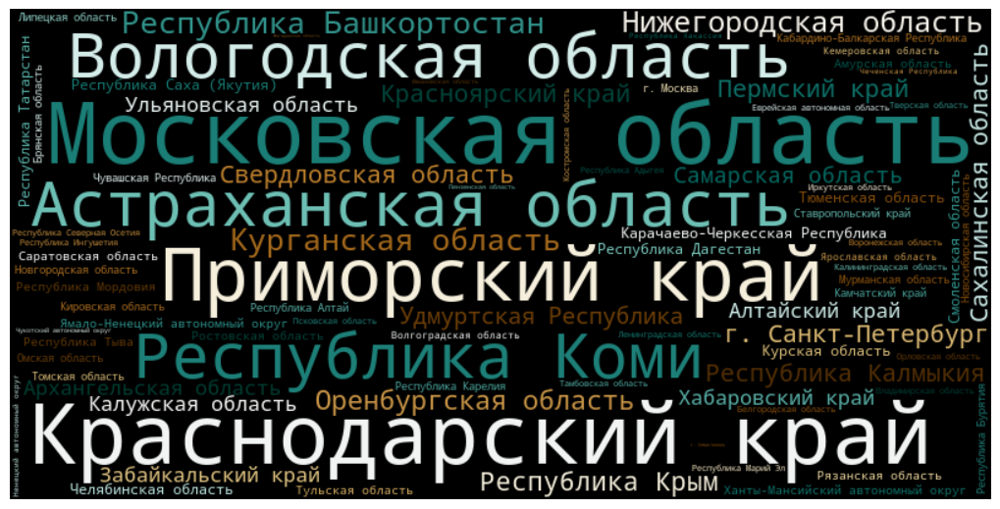

WIND


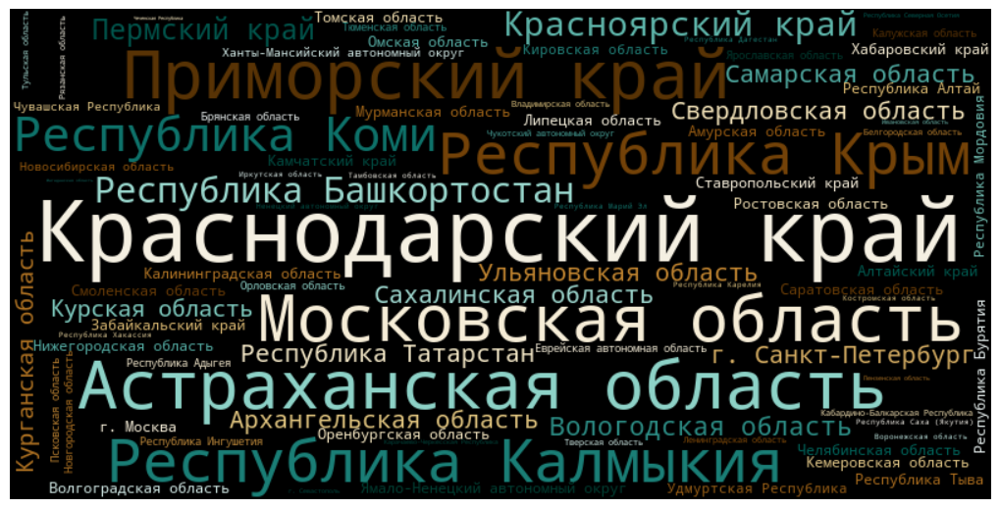

TARGET


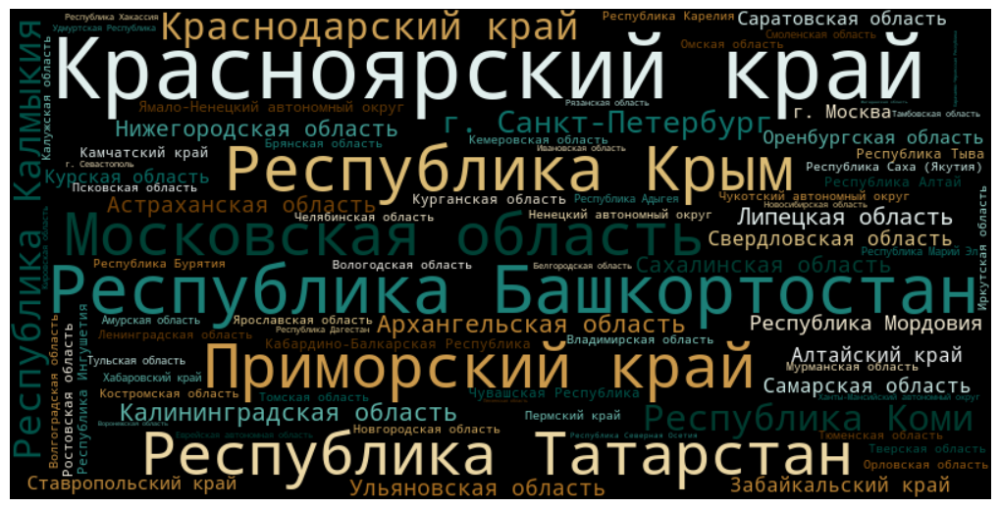

In [81]:
import pandas as pd
from wordcloud import WordCloud
import matplotlib.pyplot as plt

def to_cloud_atd(df):
    df_drop = df[df['Субъект']!='nothing']
    
    wordcloud = WordCloud(
        width=800,
        height=400,
    colormap = 'BrBG',
        background_color='black',
        min_font_size=2,
        max_font_size=70
    ).generate_from_frequencies(dict(zip(df_drop['Субъект'],df_drop['Количество'])))
    
    
    plt.figure(figsize=(10, 5))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis('off')
    plt.subplots_adjust(left=0, right=1, top=1, bottom=0)
    
    plt.show()
    
print('DATA')    
to_cloud_atd(locATD_data_df)

print('WIND')    
to_cloud_atd(locATD_wind_df)

print('TARGET')    
to_cloud_atd(locATD_target_df)

In [82]:
locATD_data_df.head(15)

,Субъект,Количество,"Количество, %",df
0,Московская область,1700,5.60,data
1,Краснодарский край,1600,5.27,data
2,Приморский край,1212,3.99,data
3,Астраханская область,867,2.85,data
4,Вологодская область,851,2.80,data
5,Республика Коми,845,2.78,data
6,Республика Башкортостан,815,2.68,data
7,Курганская область,801,2.64,data
8,Нижегородская область,778,2.56,data
9,Оренбургская область,769,2.53,data


In [83]:
locATD_wind_df.head(15)

,Субъект,Количество,"Количество, %",df
0,Краснодарский край,1262,9.81,wind
1,Астраханская область,725,5.64,wind
2,Приморский край,716,5.57,wind
3,Московская область,663,5.16,wind
4,Республика Калмыкия,572,4.45,wind
5,Республика Крым,543,4.22,wind
6,Республика Коми,462,3.59,wind
7,Республика Башкортостан,449,3.49,wind
8,Красноярский край,421,3.27,wind
9,Пермский край,262,2.04,wind


In [84]:
locATD_target_df.head(15)

,Субъект,Количество,"Количество, %",df
0,Красноярский край,228,7.28,target
1,Республика Башкортостан,129,4.12,target
2,Республика Крым,116,3.71,target
3,Приморский край,113,3.61,target
4,Республика Татарстан,107,3.42,target
5,Московская область,106,3.39,target
6,Краснодарский край,105,3.35,target
7,Республика Калмыкия,104,3.32,target
8,Республика Коми,94,3.00,target
9,г. Санкт-Петербург,93,2.97,target


In [85]:
locATD_all_df = pd.concat([locATD_data_df.head(10), locATD_wind_df.head(10), locATD_target_df.head(10)])
locATD_all_df = locATD_all_df.reset_index(drop = True)

In [86]:
custom_colors = ['#01665e', '#5ab4ac', '#d8b365']
px.histogram(locATD_all_df, x = 'Субъект', y = 'Количество, %',
             color = 'df', barmode='group', color_discrete_sequence=custom_colors,
            title = 'Частота ОПЯ в субъектах, data - все, wind и target - сильные ветры')

### Субъекты с определенными классами интенсивности скорости ветра

In [113]:
def normalise_text(text):
    text = text.lower()

    # сурово регулярками выкидываем мусорные символы
    text = re.sub('[^а-яa-z0-9 ]', '', text)
    text = text.replace('марий эл', 'марий-эл')
    text = text.replace('северная осетия', 'северная_осетия')
    text = text.replace('саха якутия', 'саха')
    text = text.replace('якутия', 'саха')
    # Убираем стоп-слова
    words = text.split()
    filtered_words = [word for word in words if word not in stops]
    
    return ' '.join(filtered_words).strip()

def to_loc_num(loc):
    lst = []
    loc = loc.split()
    for i in loc:
        lst.append(subs_nums[i])
    return lst

wind_work = wind
stops = ['округ', 'область', 'автономный', 'г', 'край', 'республика']
wind_work['Location_ATD4'] = wind_work['Location_ATD4'].fillna('')
wind_work['Location_clean'] = wind_work['Location_ATD4'].apply(normalise_text)

word_cnt = Counter(word_tokenize(' '.join(wind_work['Location_clean'].values)))

subs = {
    "#PAD#": 0, "#UNK#": 1
}

for word, _ in word_cnt.most_common():
    if word not in stops:
        subs[word] = _

subs_nums = {key: index for index, key in enumerate(list(subs.keys())[2:])}
wind_work['loc_num'] = wind_work['Location_clean'].apply(to_loc_num)

In [124]:
df = wind_work.explode('loc_num')

In [134]:
def to_def_sub(value):
    if str(value).isdigit():
        return list(subs_nums.keys())[int(value)]
    else:
        return ''
df['Location_clean'] = df['loc_num'].apply(to_def_sub)

In [136]:
df[df['Класс']==12]['Location_clean'].value_counts()

Location_clean
приморский             49
крым                   45
сахалинская            34
алтай                  33
алтайский              24
чукотский              20
краснодарский          17
камчатский             15
хабаровский            11
красноярский            6
                        5
кемеровская             5
ингушетия               5
севастополь             4
белгородская            3
калининградская         3
иркутская               2
тыва                    2
новосибирская           1
омская                  1
архангельская           1
кировская               1
астраханская            1
ростовская              1
тюменская               1
магаданская             1
хакассия                1
кабардинобалкарская     1
ненецкий                1
Name: count, dtype: int64

In [142]:
length = len(df[df['Location_clean']=='приморский'])
print(f'Количество: {length}')
df[df['Location_clean']=='приморский']['Класс'].value_counts()/length*100

Количество: 716


Класс
0     50.837989
10    12.709497
8     10.893855
11    10.335196
9      6.843575
12     6.843575
7      0.837989
6      0.698324
Name: count, dtype: float64

In [143]:
length = len(df[df['Location_clean']=='крым'])
print(f'Количество: {length}')
df[df['Location_clean']=='крым']['Класс'].value_counts()/length*100

Количество: 543


Класс
10    35.359116
8     23.388582
0     18.047882
9      9.944751
12     8.287293
11     2.946593
7      1.473297
6      0.368324
5      0.184162
Name: count, dtype: float64

In [149]:
top_sub_15 = list(pd.DataFrame(df['Location_clean'].value_counts()).reset_index()['Location_clean'])[:15]

In [153]:
top_sub_15 = list(pd.DataFrame(df['Location_clean'].value_counts()).reset_index()['Location_clean'])[:15]
for sub in top_sub_15:
    length = len(df[df['Location_clean']==sub])
    print(f'\nКоличество "{sub}": {length}')
    print(df[df['Location_clean']==sub]['Класс'].value_counts()/length*100)


Количество "краснодарский": 1262
Класс
9     30.110935
8     28.922345
0     21.394612
10    11.331220
11     3.645008
7      2.773376
12     1.347068
6      0.316957
5      0.158479
Name: count, dtype: float64

Количество "астраханская": 725
Класс
0     83.724138
8      5.655172
9      4.275862
10     3.862069
7      1.517241
11     0.551724
5      0.137931
12     0.137931
6      0.137931
Name: count, dtype: float64

Количество "приморский": 716
Класс
0     50.837989
10    12.709497
8     10.893855
11    10.335196
9      6.843575
12     6.843575
7      0.837989
6      0.698324
Name: count, dtype: float64

Количество "московская": 663
Класс
7     32.428356
8     23.831071
0     21.568627
10     9.954751
9      8.446456
6      1.809955
5      1.357466
11     0.301659
3      0.150830
4      0.150830
Name: count, dtype: float64

Количество "калмыкия": 572
Класс
0     55.769231
9     18.531469
8     12.412587
10     9.965035
11     2.622378
7      0.524476
3      0.174825
Name: count, dty